# Here, example fields are plotted for selected times, days and model output fields.

In [1]:
from enstools.io import read
from enstools.plot import contour
import matplotlib.pyplot as plt
import matplotlib as mpl
import glob
import pandas as pd
import xarray as xr
import numpy as np
import dask
import seaborn as sns
import logging
import cartopy.crs as ccrs
import cartopy.feature as cf
from tqdm import tqdm
from misc_functions import my_contour
from misc_functions import get_radar_mask
from misc_functions import get_prec_time
from misc_functions import compute_theta_v
from misc_functions import get_color_and_lw
from misc_functions import get_prec_data

#dfdf
homedir = '/home/m/M.Hirt/'

plt.style.use(['seaborn-deep', '/home/m/M.Hirt/poster.mplstyle'])
%matplotlib widget
logger = logging.getLogger()
logger.setLevel(logging.INFO)



In [2]:
import warnings
warnings.filterwarnings("ignore")

plt.rcParams['figure.figsize'] = [10,10]

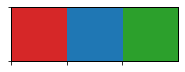

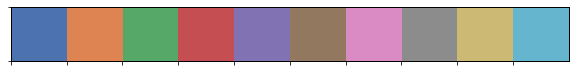

In [3]:
%matplotlib inline
current_palette = sns.color_palette('tab10')
grid_colors =[ current_palette[i] for i in [3,0,2]]
secondary_colors= sns.color_palette('deep')#[sns.color_palette('deep')[i] for i in [3,9,8,2,1,0,4,6,7]]
sns.palplot(grid_colors)
sns.palplot(secondary_colors)

In [4]:
selected_run_list =  ['reference',
                      #'2moment_reference',
                      #'cpp2.11_a0.3_wmax0.5_kref38_theta1.5_sso50.0_tau1800.0',
                      #'cpp2.11_a0.3_wmax0.5_kref38_theta1.5_sso50.0_tau3600.0',
                      #'cpp2.11_a0.2_wmax0.5_kref38_theta1.5_sso50.0_tau600.0',
                      #'cpp2.11_a0.3_wmax0.5_kref36_theta1.5_sso50.0_tau1800.0',
                      #'cpp2.11_a0.2_wmax0.5_kref38_theta1.5_sso50.0_tau1800.0',
                      #'cpp2.11_a0.15_wmax0.5_kref38_theta1.5_sso50.0_tau600.0',
                      'cpp2.17_tanh_a1.2_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0',
                      'cpp2.17_tanh_a2.0_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0',
                      'PSP2a0.8_cpp2.17_tanh_a1.2_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0',
                      #'PSP2',
                      'radar']


ds_list=[]
rmask_list= []
for date in  [ '20160529','20160530','20160531', '20160601', '20160602', '20160603', '20160604', #'20160527', '20160528', , '20160608', '20160609'
            '20160605','20160606', '20160607']: 
    logging.info(date)
    prec_arrays = get_prec_data(run_names = selected_run_list, date=date)
    prec_arrays['start_date'] = prec_arrays.time.isel(time=0).time -np.timedelta64(1,'h') # data starts at 1, not 00 --> subtract 1 hour for start_date
    prec_arrays['leadtime'] = (prec_arrays.time - prec_arrays.start_date)/ np.timedelta64(1,'h')
    prec_arrays = prec_arrays.set_coords(['leadtime', 'start_date'])
    prec_arrays = prec_arrays.swap_dims({'time':'leadtime'})
    del prec_arrays['time']
    #prec_arrays['hour'] = prec_arrays.time
    
    ds_list.append(prec_arrays)
    radar_mask = get_radar_mask(date=date, use_time_dependent=False) 
    rmask_list.append(radar_mask)
prec_arrays = xr.concat(ds_list, dim ='start_date')
radar_mask = xr.concat(rmask_list, dim ='time')
radar_mask = radar_mask.rename({'time':'start_date'})


INFO: 20160529
100%|██████████| 5/5 [00:25<00:00,  4.52s/it]
INFO: 20160530
100%|██████████| 5/5 [00:25<00:00,  4.60s/it]
INFO: 20160531
100%|██████████| 5/5 [00:27<00:00,  4.80s/it]
INFO: 20160601
100%|██████████| 5/5 [00:25<00:00,  4.56s/it]
INFO: 20160602
100%|██████████| 5/5 [00:27<00:00,  4.78s/it]
INFO: 20160603
100%|██████████| 5/5 [00:26<00:00,  4.63s/it]
INFO: 20160604
100%|██████████| 5/5 [00:25<00:00,  4.61s/it]
INFO: 20160605
100%|██████████| 5/5 [00:27<00:00,  4.85s/it]
INFO: 20160606
100%|██████████| 5/5 [00:26<00:00,  4.67s/it]
INFO: 20160607
100%|██████████| 5/5 [00:27<00:00,  4.90s/it]


In [5]:
#prec_arrays['cppert05_det_a0.1_theta0.5_sso100.0_H0500.0_HPBL500.0']
#prec_arrays = prec_arrays.rename( {'cppert05_PSP2':'cppert05_det_a0.1_theta0.5_sso100.0_H0500.0_HPBL500.0'})

In [5]:
#prec_arrays = prec_arrays.rename_vars({'cppert05_det_a0.1_theta0.5_sso100.0_H0500.0_HPBL500.0': 'PSP2+CPPERT'})
#prec_arrays = prec_arrays.rename_vars({'cpp2.11_a0.3_wmax0.5_kref38_theta1.5_sso50.0_tau1800.0': 'CPP2.11_30min'})
#prec_arrays = prec_arrays.rename_vars({'cpp2.11_a0.3_wmax0.5_kref38_theta1.5_sso50.0_tau3600.0': 'CPP2.11_1h'})
#prec_arrays = prec_arrays.rename_vars({'cpp2.11_a0.2_wmax0.5_kref38_theta1.5_sso50.0_tau600.0': 'CPP2.11_10min'})
#prec_arrays = prec_arrays.rename_vars({'cpp2.11_a0.3_wmax0.5_kref36_theta1.5_sso50.0_tau1800.0': 'CPP2.11_30min_h36'})
#prec_arrays = prec_arrays.rename_vars({'cpp2.11_a0.2_wmax0.5_kref38_theta1.5_sso50.0_tau1800.0': 'CPP2.11_30min_a2'})
#prec_arrays = prec_arrays.rename_vars({'cpp2.11_a0.15_wmax0.5_kref38_theta1.5_sso50.0_tau600.0': 'CPP2.11_10min_a1.5'})
prec_arrays = prec_arrays.rename_vars({'cpp2.17_tanh_a1.2_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0': 'CPP2.17-a1.2'})
prec_arrays = prec_arrays.rename_vars({'cpp2.17_tanh_a2.0_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0': 'CPP2.17-a2'})
prec_arrays = prec_arrays.rename_vars({'PSP2a0.8_cpp2.17_tanh_a1.2_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0': r'PSP2 ($\alpha=0.8$) + CPP'})

In [6]:
%load_ext autoreload
%autoreload 2

from misc_functions import plot_prec_fields

# Precipitation fields

In [7]:
selected_run_list =  ['reference', 
                    #'2moment_reference',
                    # 'CPP2.11_30min',
                      #'CPP2.11_1h',
                     # 'CPP2.11_10min',
                      #'CPP2.11_30min_h36',
                      #'CPP2.11_30min_a2',
                      #'CPP2.11_10min_a1.5',
                      'CPP2.17-a1.2',
                      'CPP2.17-a2',
                      r'PSP2 ($\alpha=0.8$) + CPP',
                      'radar',]

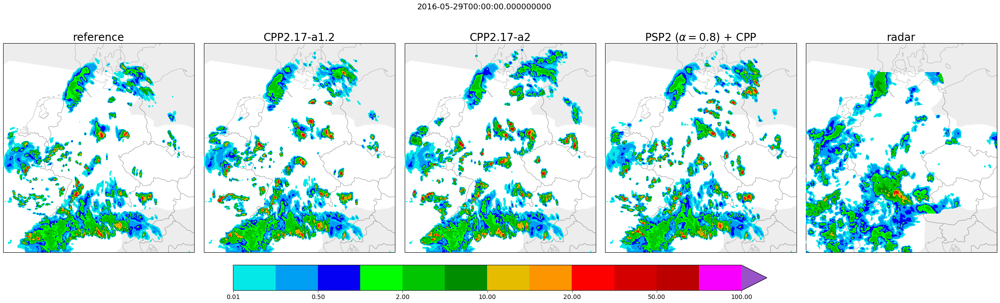

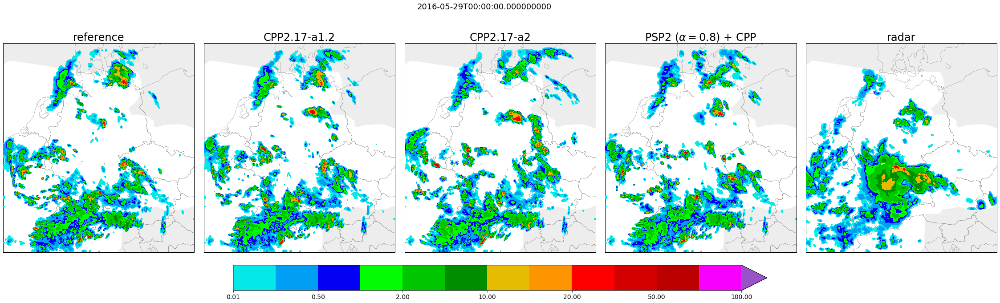

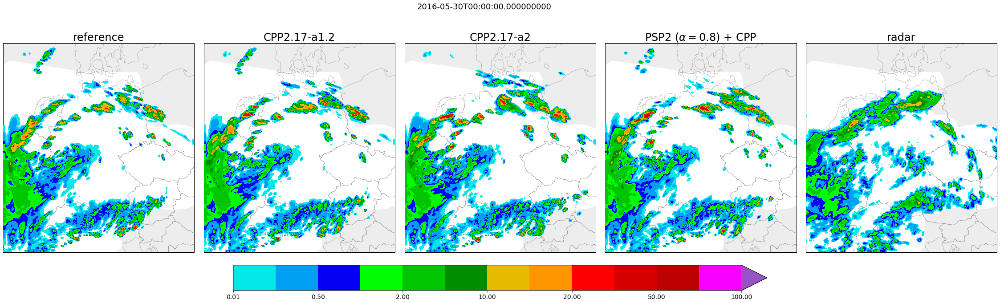

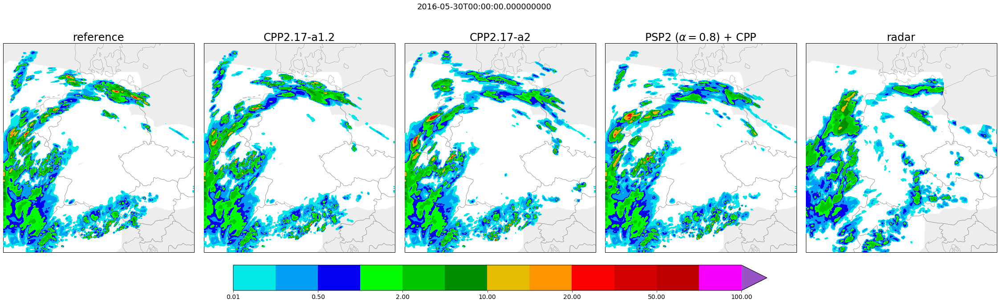

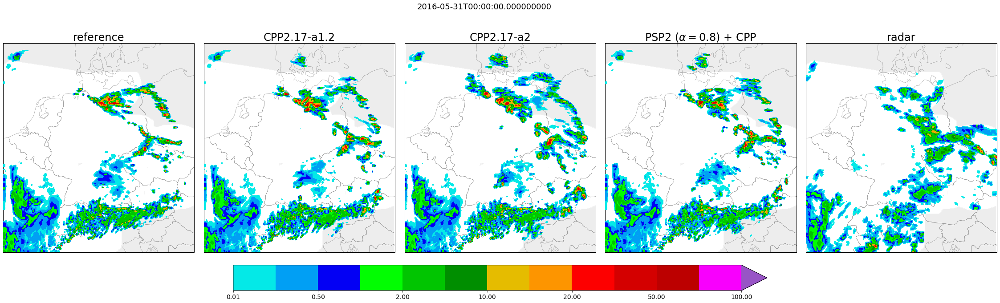

...

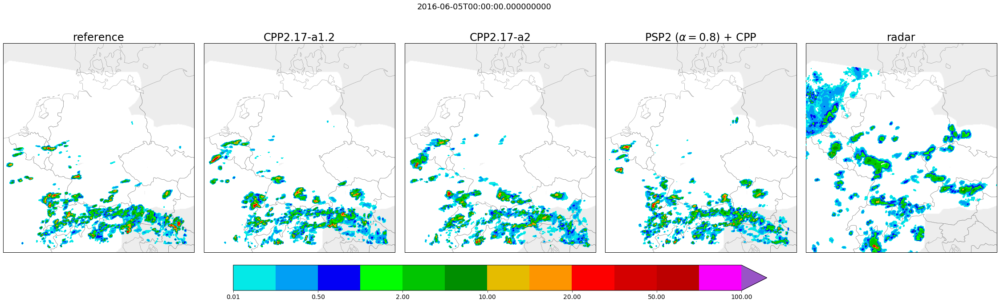

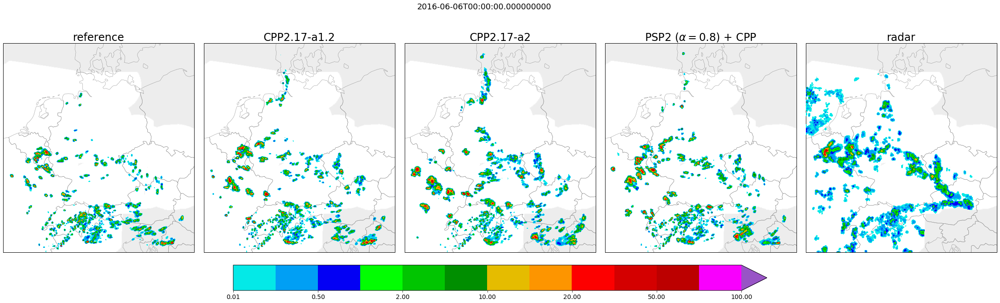

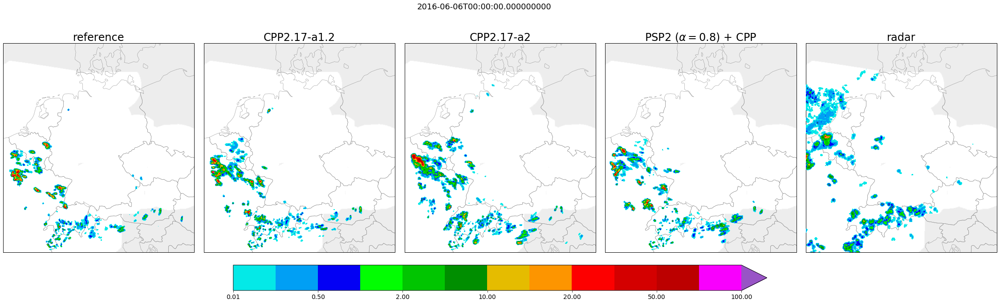

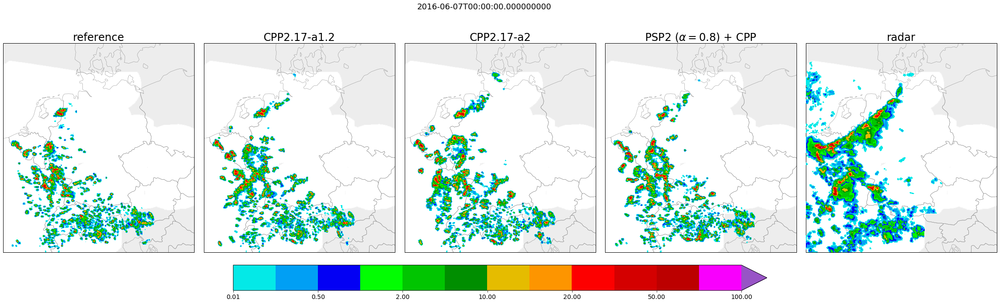

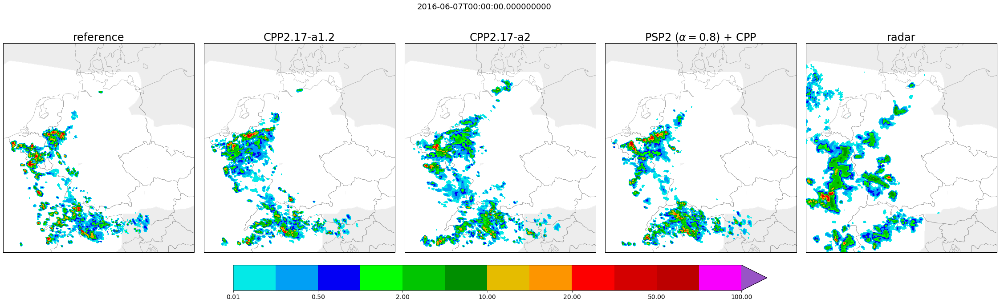

In [8]:
from misc_functions import plot_prec_fields

levs = np.array([0.01,0.1, 0.5, 1., 2., 6., 10., 15, 20., 30, 50,
                     70, 100]) 

for i,date in enumerate(prec_arrays.start_date.values):
    ti = 15
    prec = prec_arrays.sel(start_date=date)
    prec = prec.rename_dims({'leadtime':'time'})
    prec = prec.rename({'leadtime':'time'})
    fig,axs= plot_prec_fields(prec, ti =ti, radar_mask=radar_mask.isel(start_date=i), levels = levs,names = selected_run_list ,)
    #axs[0].set_title('(a) Radar')
    #axs[1].set_title('(b) Reference')
    #axs[2].set_title('(c) CPPERT')
    fig.suptitle(date,fontsize=18)

    ti = 19
    fig,axs= plot_prec_fields(prec, ti =ti, radar_mask=radar_mask.isel(start_date=i), levels = levs,names = selected_run_list ,)
    #axs[0].set_title('(a) Radar')
    #axs[1].set_title('(b) Reference')
    #axs[2].set_title('(c) CPPERT')
    fig.suptitle(date,fontsize=18)



# theta-v

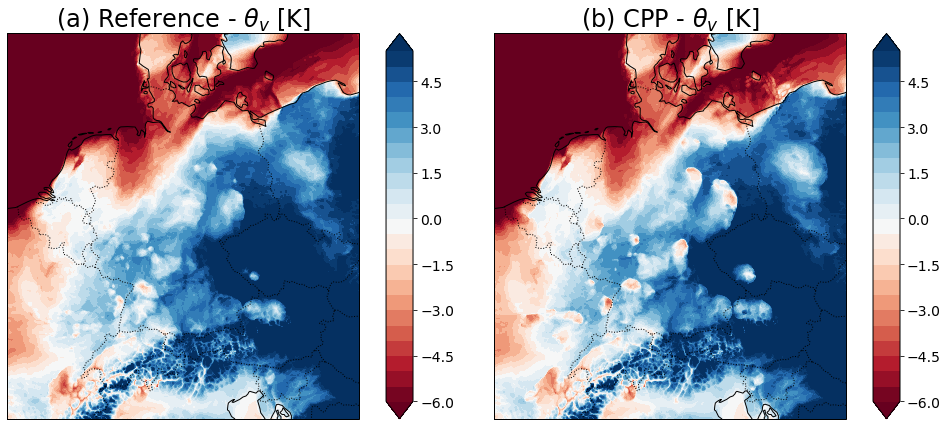

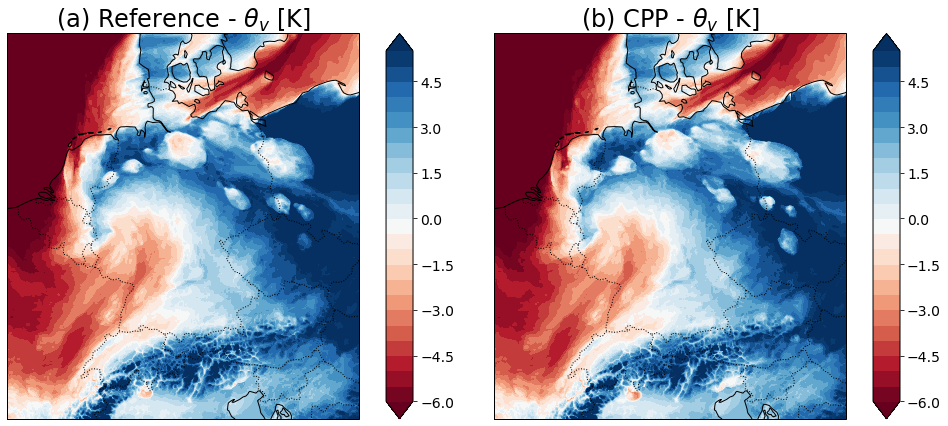

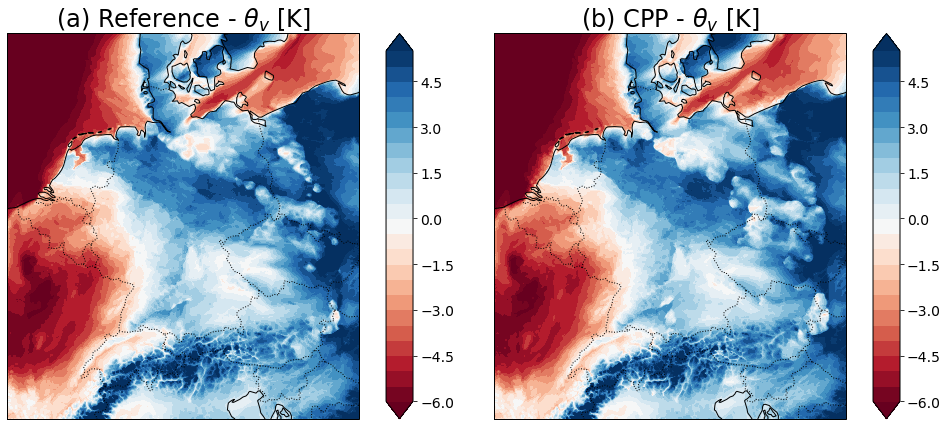

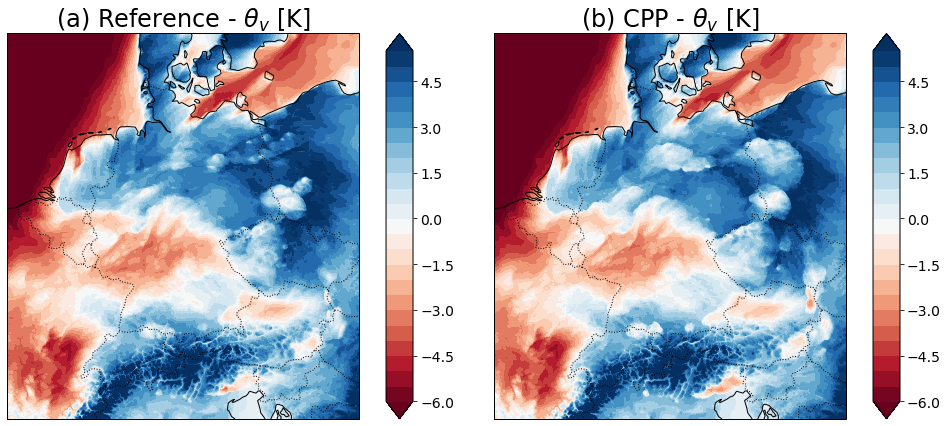

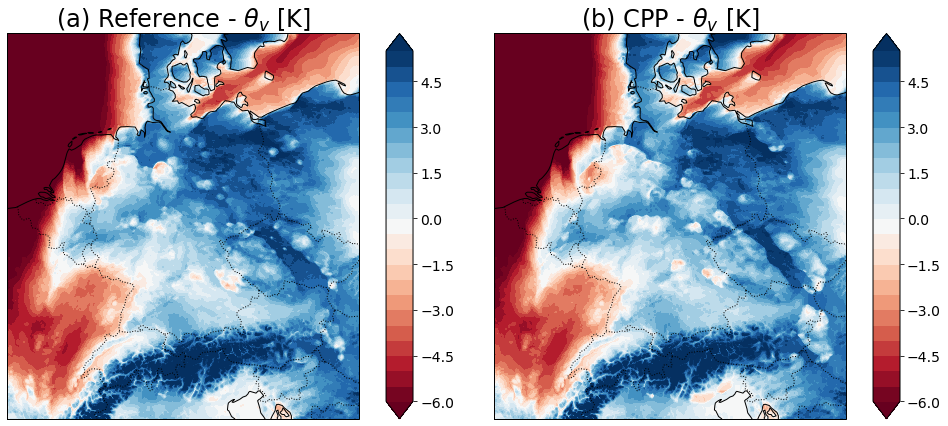

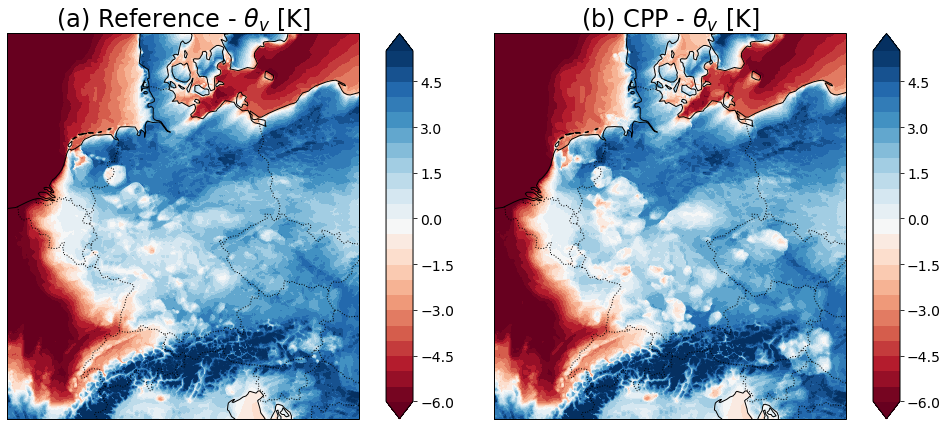

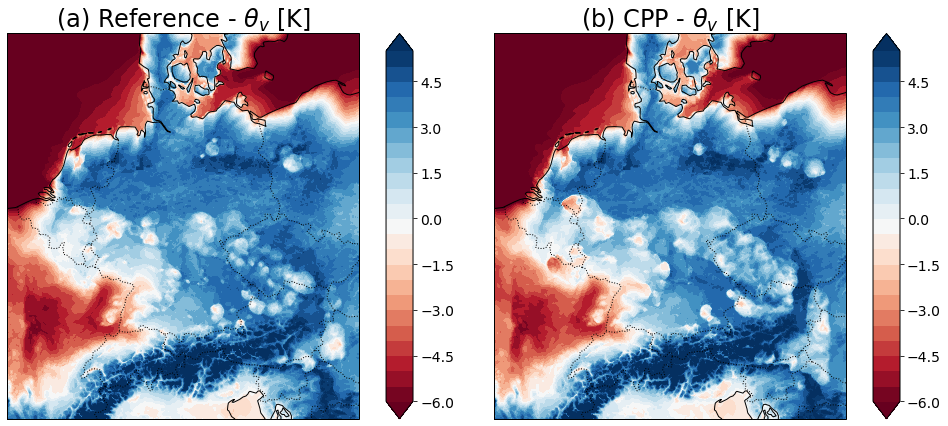

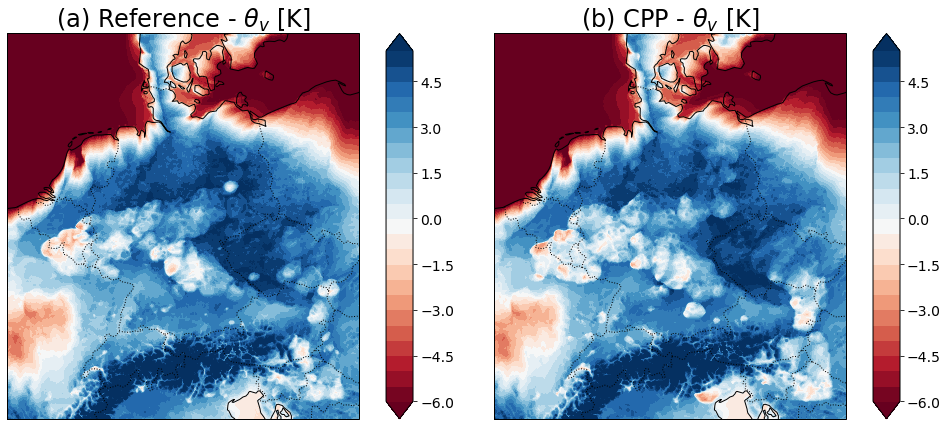

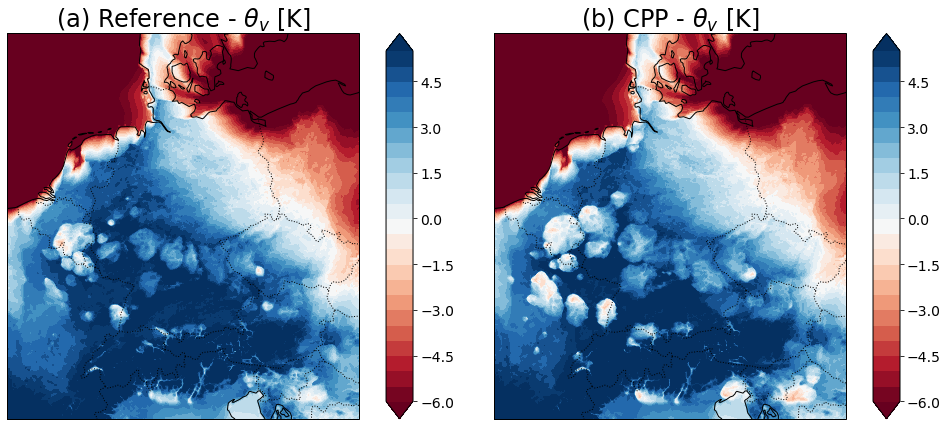

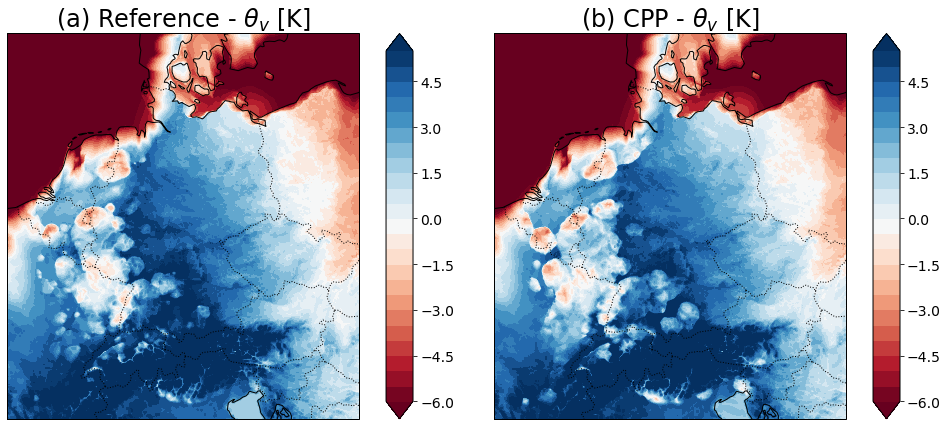

In [14]:
ti = 17
from misc_functions import get_data

for date in  [ '20160529','20160530','20160531', '20160601', '20160602', '20160603', '20160604', #'20160527', '20160528', , '20160608', '20160609'
            '20160605','20160606', '20160607']: 
    cppert_name = 'cpp2.17_tanh_a1.2_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0'
    dsets = dict()
    dsets['ref'] = get_data(run_name = 'reference', load_hourly=True, date=date)
    dsets['cppert'] = get_data(run_name = cppert_name, load_hourly=True, date = date)

    kws = dict(levels = np.arange (-6,6,.5), cmap='RdBu')
    projection = ccrs.RotatedPole(
            pole_latitude=dsets['cppert'].rotated_pole.grid_north_pole_latitude,
            pole_longitude=dsets['cppert'].rotated_pole.grid_north_pole_longitude)
    fig, axs = plt.subplots(ncols=2, subplot_kw={'projection': projection},
                            sharex=True, sharey=True, figsize=[16,8])
    theta = dsets['ref'].theta_v_sfc.isel(time=ti)
    theta_pert = theta - theta.mean(['rlon', 'rlat'])
    my_contour(theta_pert,figure = fig, axes = axs[0], **kws); axs[0].set_title(r'(a) Reference - $\theta_v$ [K]')
    theta = dsets['cppert'].theta_v_sfc.isel(time=ti)
    theta_pert = theta - theta.mean(['rlon', 'rlat'])
    my_contour(theta_pert,figure = fig, axes = axs[1],**kws); axs[1].set_title(r'(b) CPP - $\theta_v$ [K]')


# vertical velocity
Example fields of w in refernence run and CPP run for each day. 

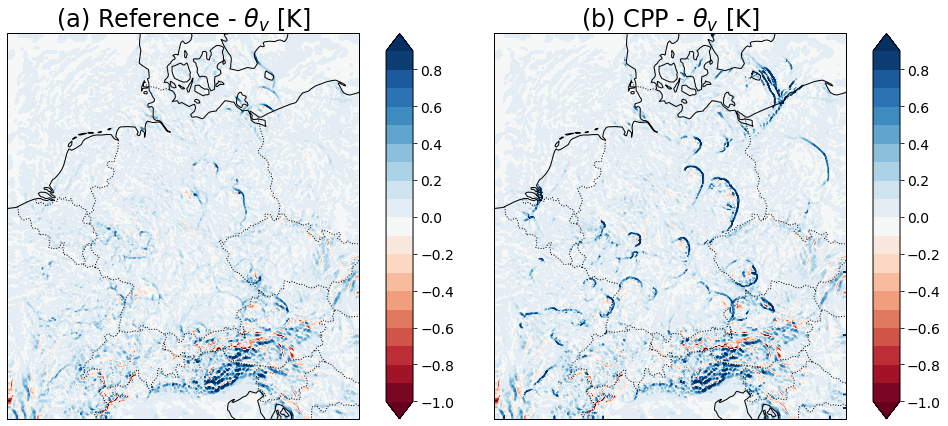

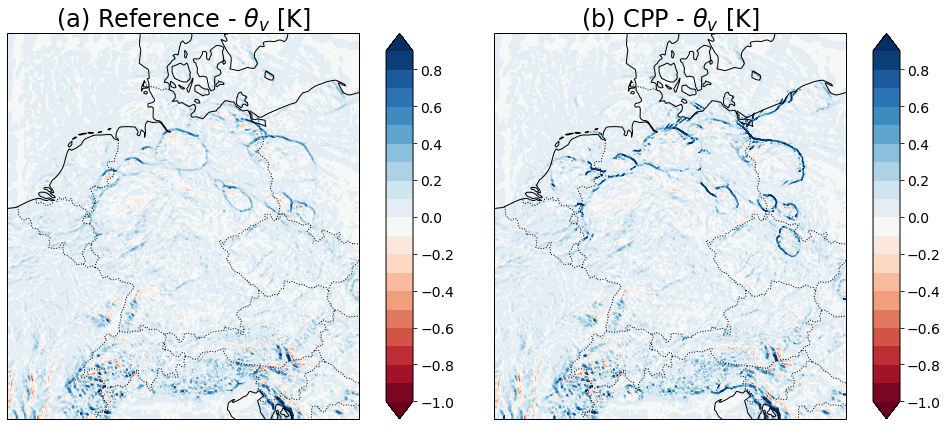

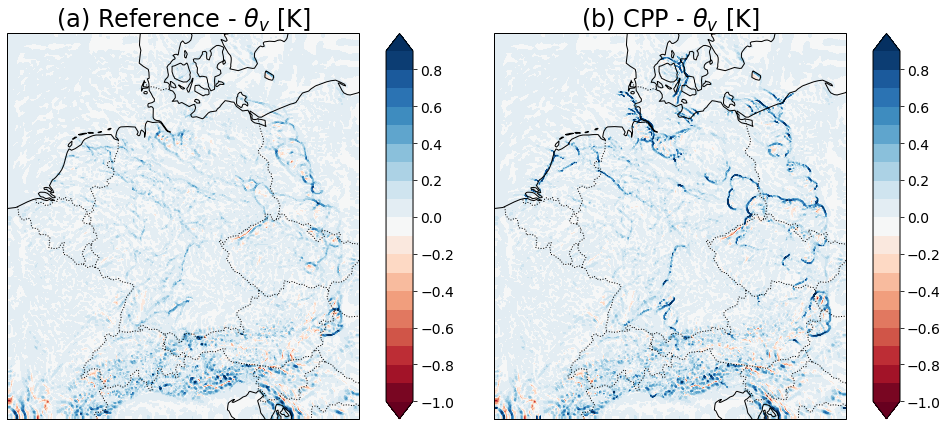

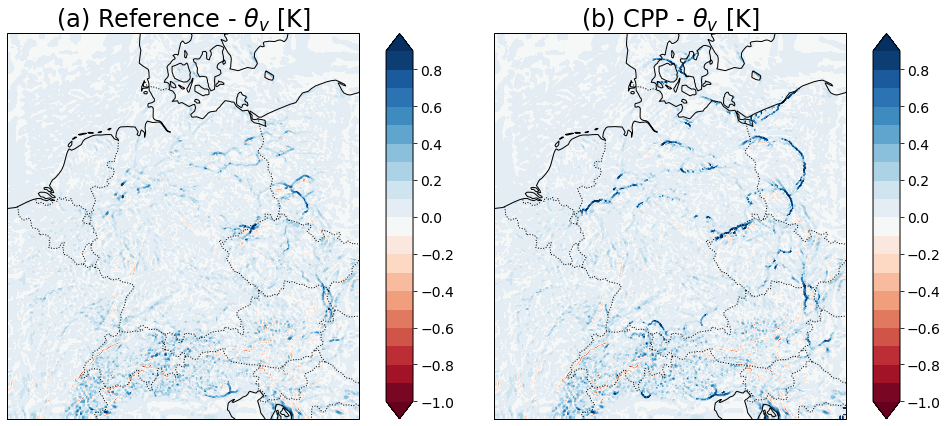

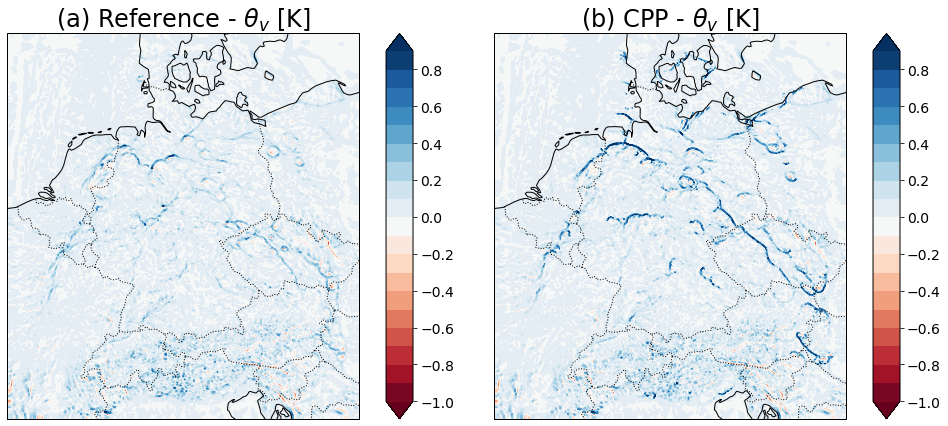

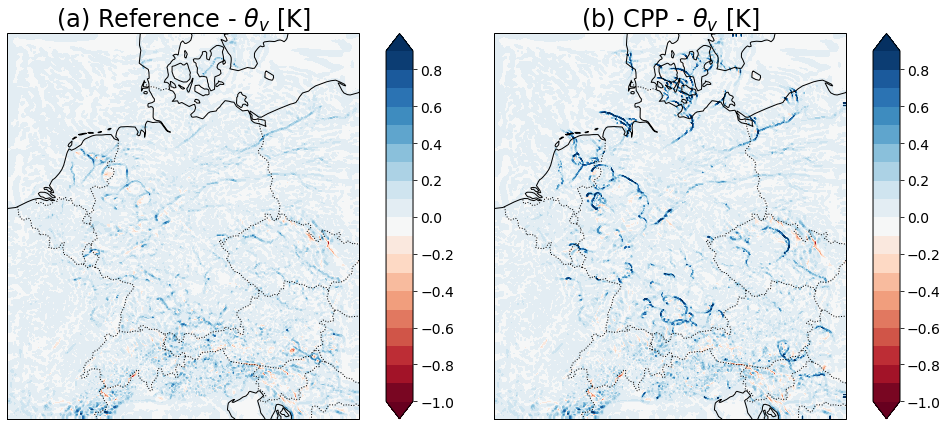

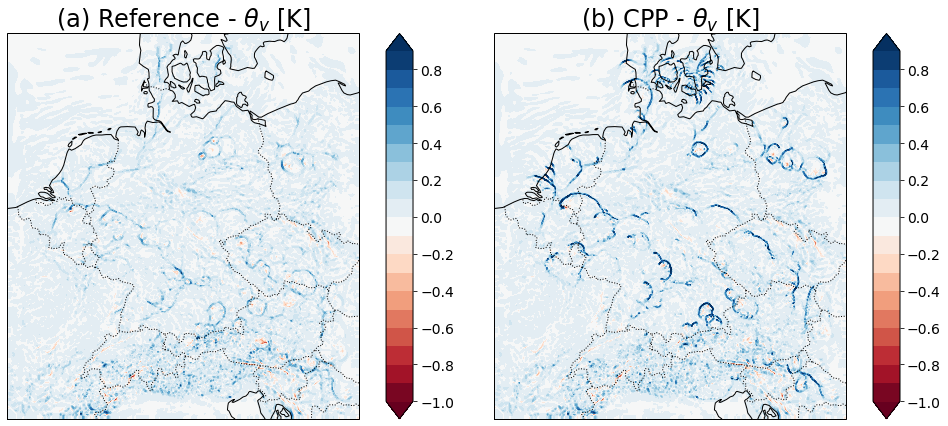

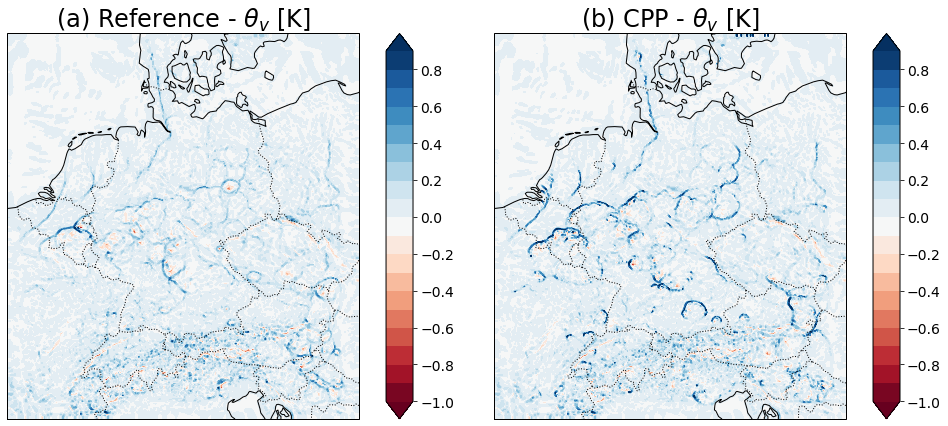

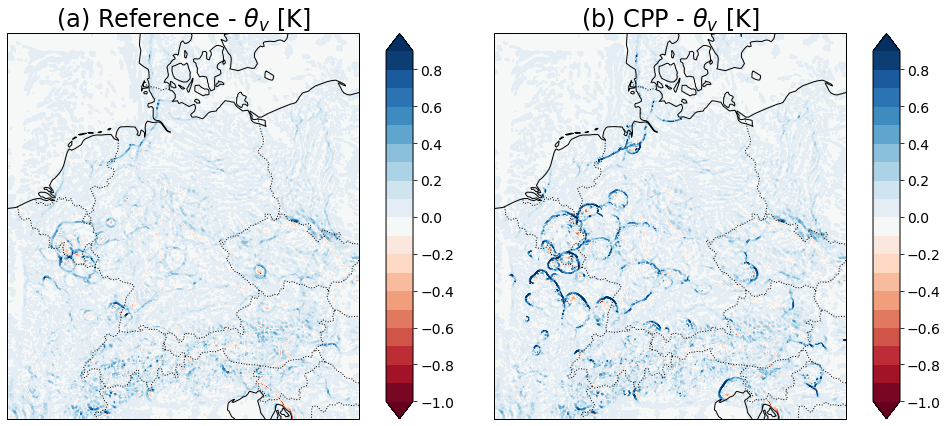

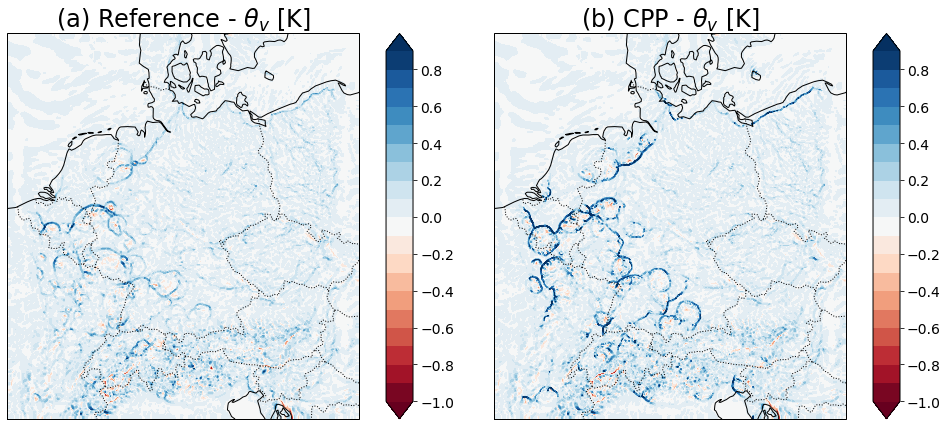

In [5]:
ti = 17
from misc_functions import get_data

for date in  [ '20160529','20160530','20160531', '20160601', '20160602', '20160603', '20160604', #'20160527', '20160528', , '20160608', '20160609'
            '20160605','20160606', '20160607']: 
    cppert_name = 'cpp2.17_tanh_a1.2_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0'
    dsets = dict()
    dsets['ref'] = get_data(run_name = 'reference', load_hourly=True, date=date)
    dsets['cppert'] = get_data(run_name = cppert_name, load_hourly=True, date = date)

    kws = dict(levels = np.arange (-1,1,.1), cmap='RdBu')
    projection = ccrs.RotatedPole(
            pole_latitude=dsets['cppert'].rotated_pole.grid_north_pole_latitude,
            pole_longitude=dsets['cppert'].rotated_pole.grid_north_pole_longitude
        
        
    fig, axs = plt.subplots(ncols=2, subplot_kw={'projection': projection},
                            sharex=True, sharey=True, figsize=[16,8])
    my_contour(dsets['ref'].W.isel(time=ti, level1=45),figure = fig, axes = axs[0], **kws); axs[0].set_title(r'(a) Reference - $\theta_v$ [K]')
    my_contour(dsets['cppert'].W.isel(time=ti, level1=45),figure = fig, axes = axs[1],**kws); axs[1].set_title(r'(b) CPP - $\theta_v$ [K]')


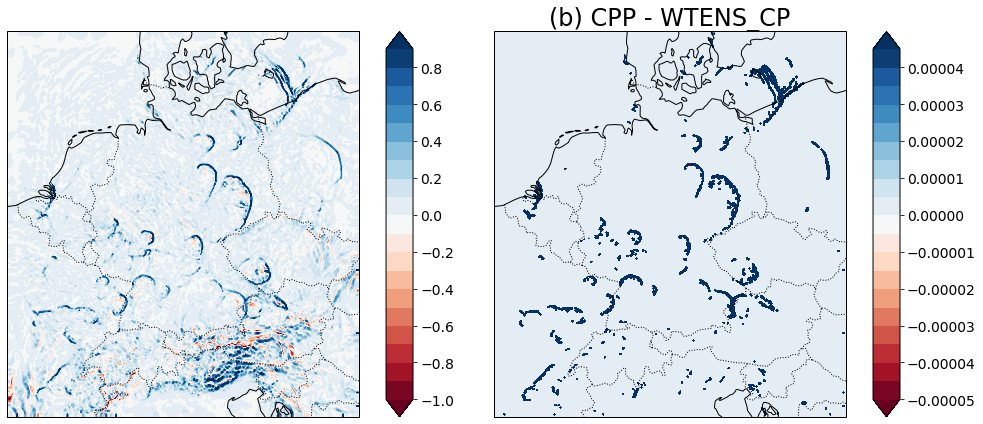

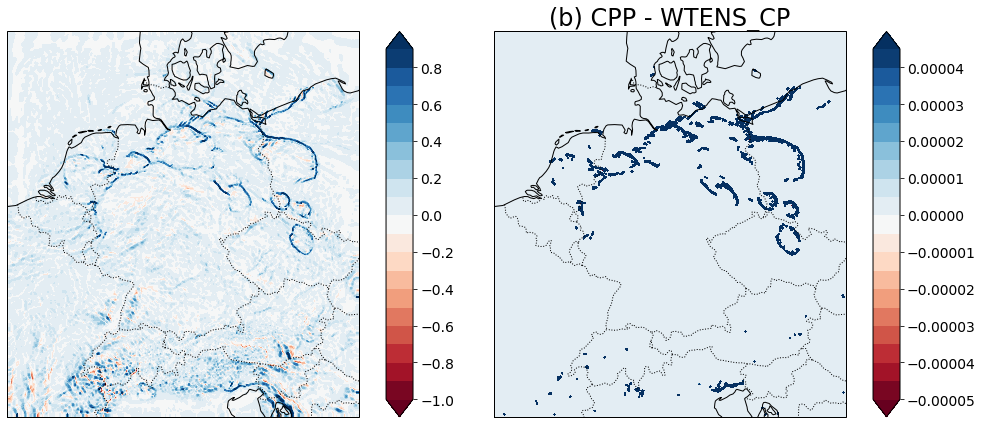

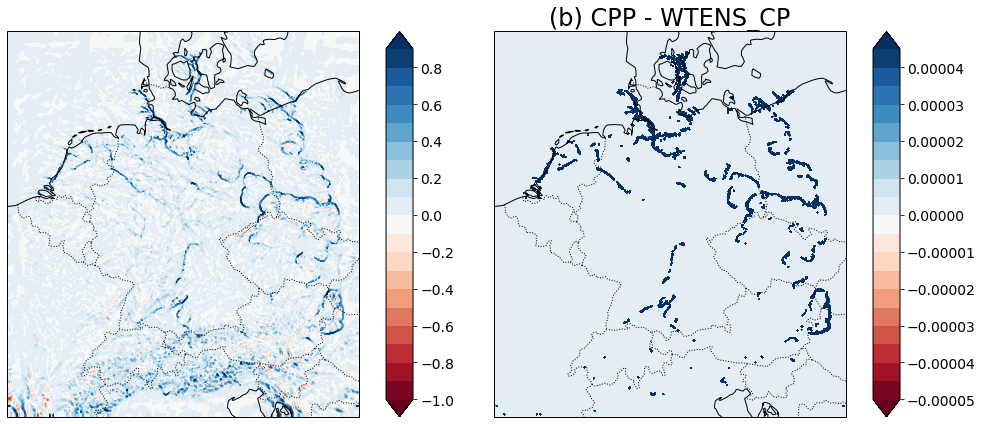

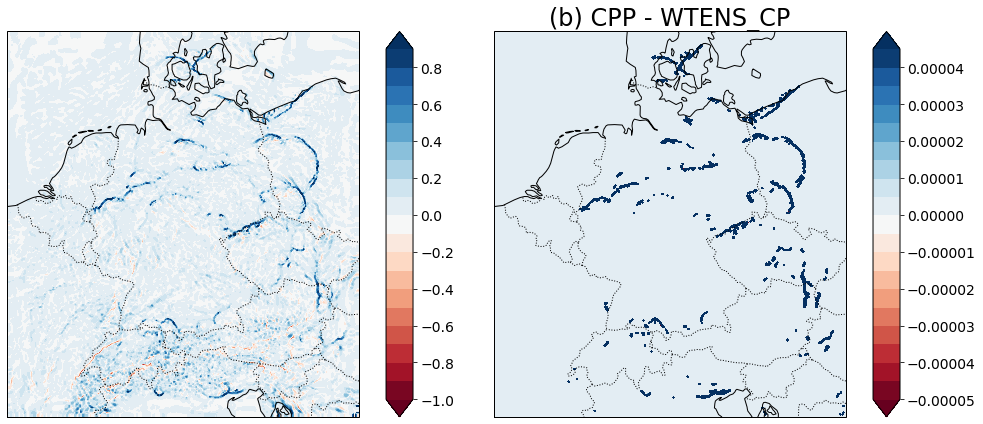

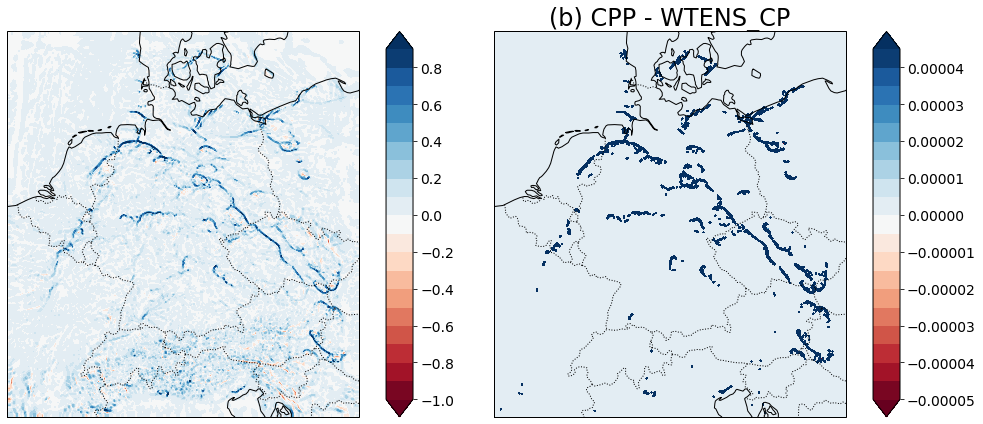

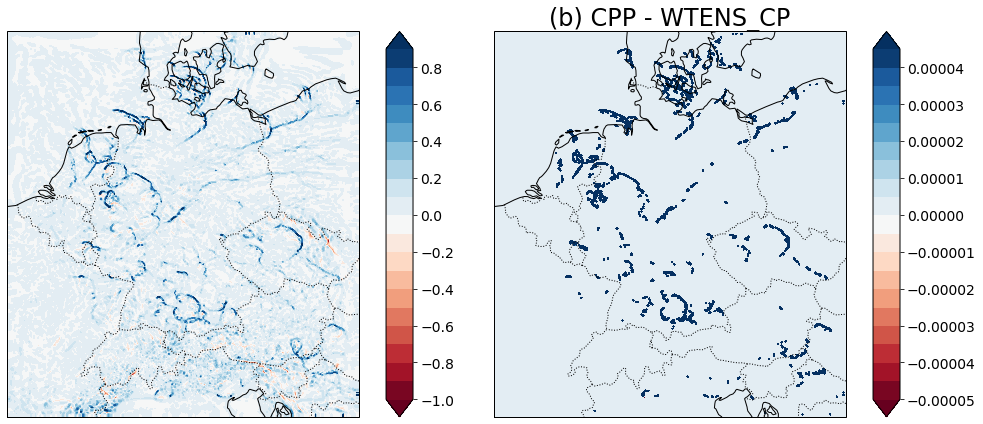

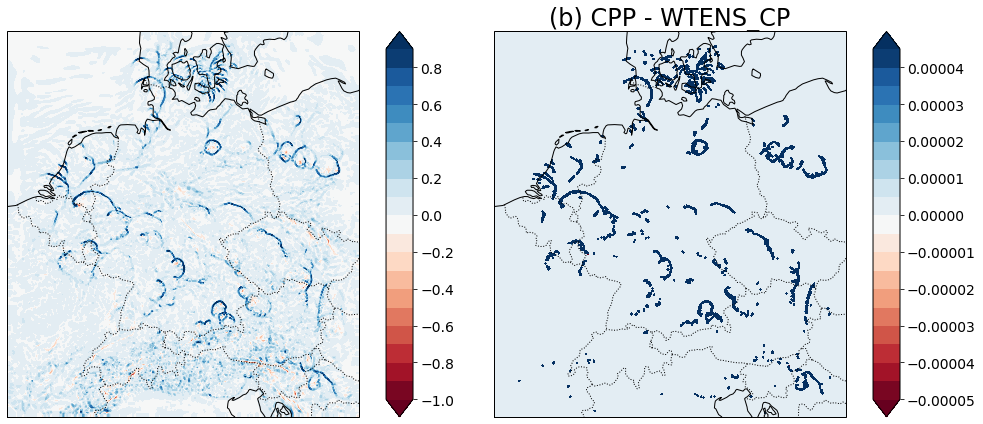

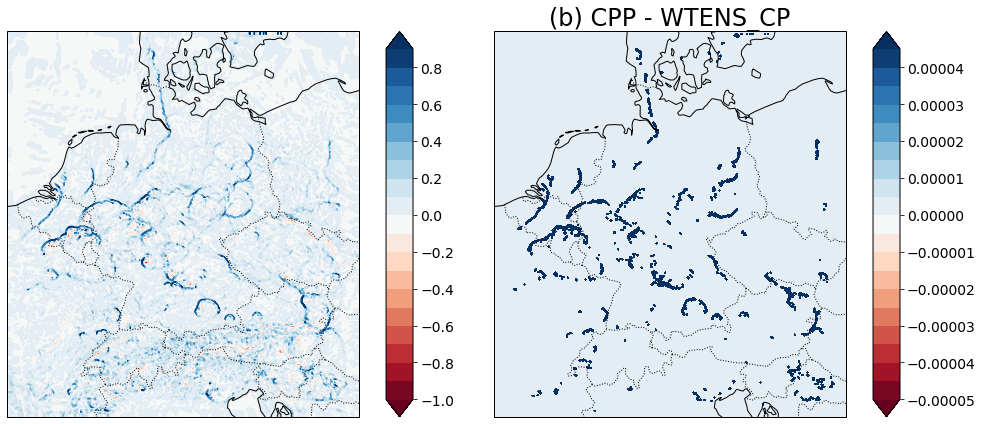

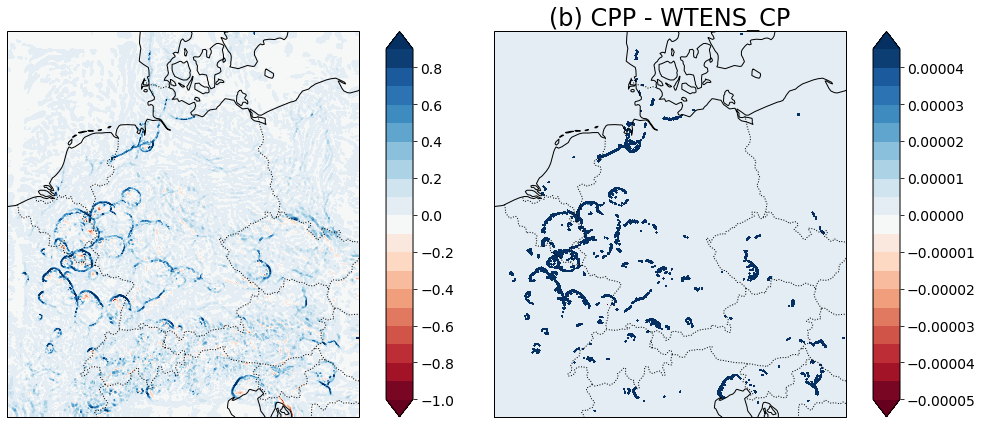

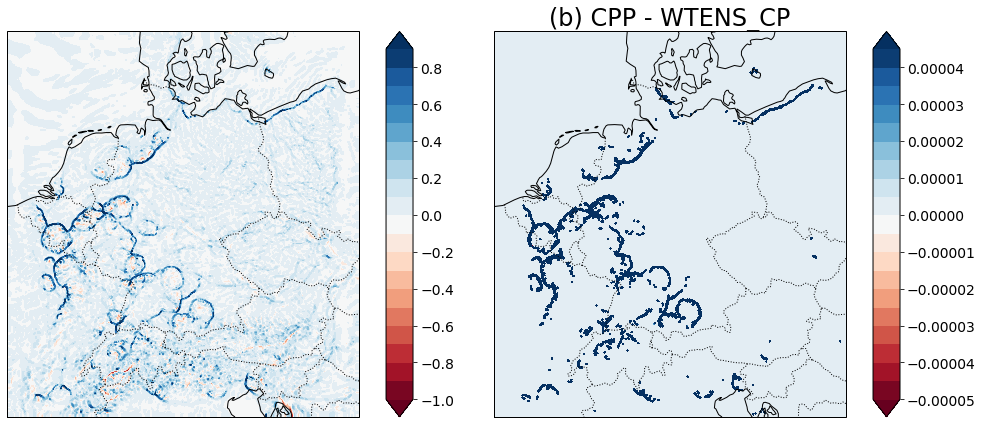

In [6]:
ti = 17
from misc_functions import get_data

for date in  [ '20160529','20160530','20160531', '20160601', '20160602', '20160603', '20160604', #'20160527', '20160528', , '20160608', '20160609'
            '20160605','20160606', '20160607']: 
    cppert_name = 'cpp2.17_tanh_a1.2_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0'
    ds = get_data(run_name = cppert_name, load_hourly=True, date = date)

    kws = dict(levels = np.arange (-1,1,.1), cmap='RdBu')
    projection = ccrs.RotatedPole(
            pole_latitude=ds.rotated_pole.grid_north_pole_latitude,
            pole_longitude=ds.rotated_pole.grid_north_pole_longitude)
    fig, axs = plt.subplots(ncols=2, subplot_kw={'projection': projection},
                            sharex=True, sharey=True, figsize=[16,8])
    my_contour(ds.W.isel(time=ti, level1=45),figure = fig, axes = axs[0],**kws); axs[1].set_title(r'(b) CPP - W')
    kws = dict(levels = np.arange(-1,1,.1)/20000, cmap='RdBu')
    my_contour(ds.WTENS_CP.isel(time=ti, level1=45),figure = fig, axes = axs[1],**kws); axs[1].set_title(r'(b) CPP - WTENS_CP')


# Interesting cases

## Land sea breezes - 6-6-2016

In [4]:
from misc_functions import get_prec_data, plot_prec_fields
date='20160606'

run_list =  ['reference',
                      'cpp2.17_tanh_a1.0_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0',
                      'cpp2.17_tanh_a1.2_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0',
                      'cpp2.17_tanh_a1.5_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0',
             'radar']


prec_arrays = get_prec_data(run_names = run_list, date = date)
radar_mask = get_radar_mask(date=date, use_time_dependent=False) 

100%|██████████| 5/5 [08:08<00:00, 86.11s/it] 


In [18]:
from misc_functions import get_data
dsets = dict()
date = 20160606
dsets['ref'] = get_data(run_name = 'reference', load_hourly=True, date=date)
#dsets['cpp2.17_a1.0'] = get_data(run_name = 'cpp2.17_tanh_a1.0_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0', load_hourly=True, date = date)
dsets['cpp2.17_a1.2'] = get_data(run_name = 'cpp2.17_tanh_a1.2_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0', load_hourly=True, date = date)
#dsets['cpp2.17_a1.5'] = get_data(run_name = 'cpp2.17_tanh_a1.5_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0', load_hourly=True, date = date)

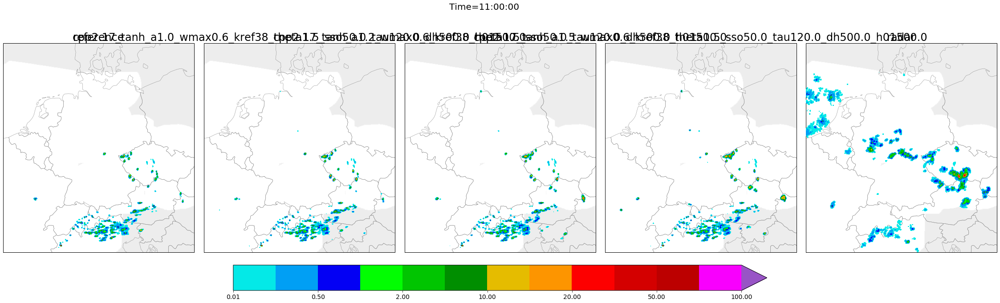

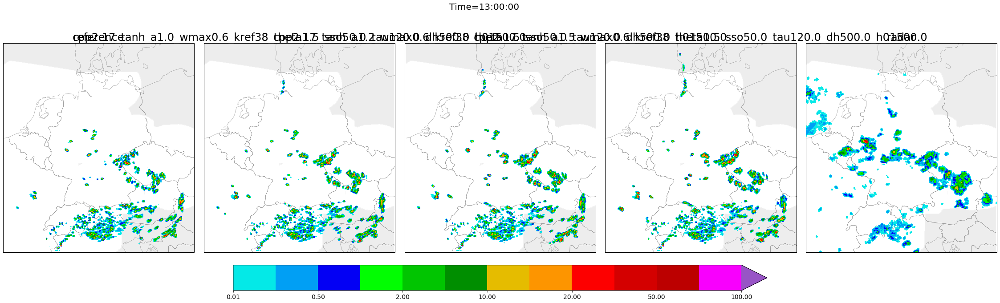

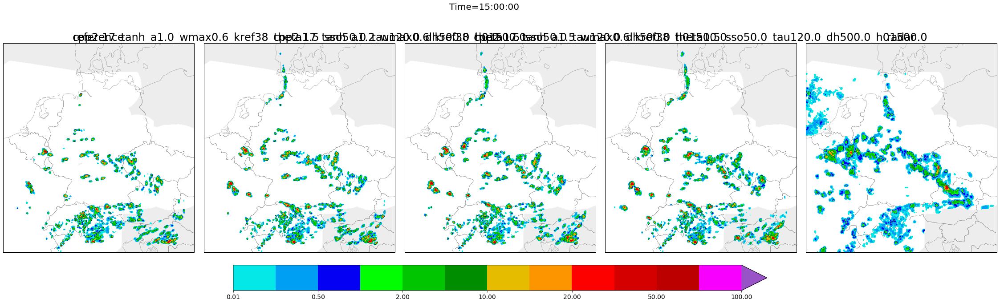

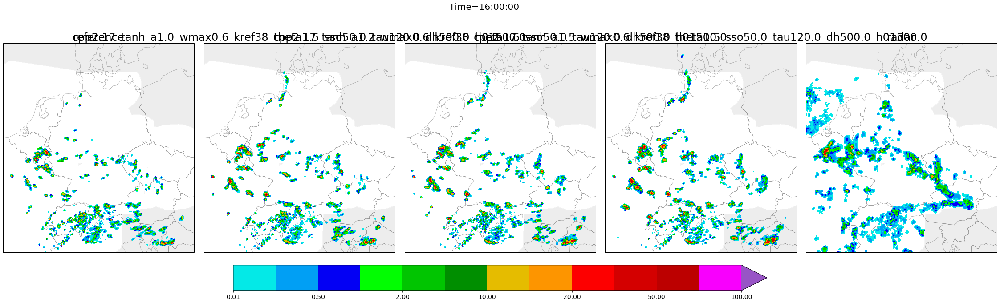

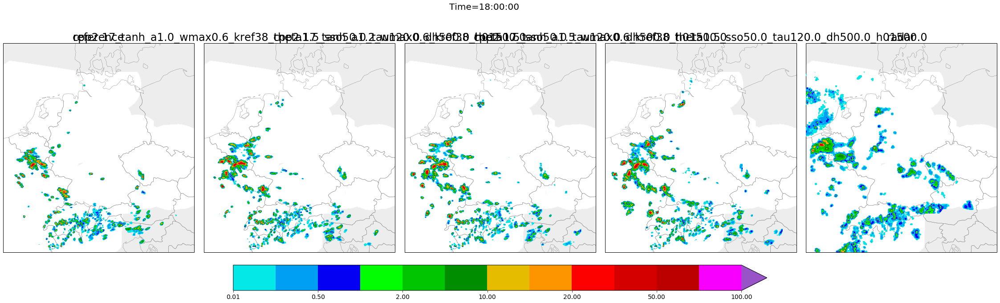

In [24]:
levs = np.array([0.01,0.1, 0.5, 1., 2., 6., 10., 15, 20., 30, 50,
                     70, 100]) 
for ti in [10,12,14,15, 17,]:
    fig,axs = plot_prec_fields(prec_arrays, ti =ti, radar_mask=radar_mask, levels = levs,names = run_list)

2016-06-06T15:00:00.000000000


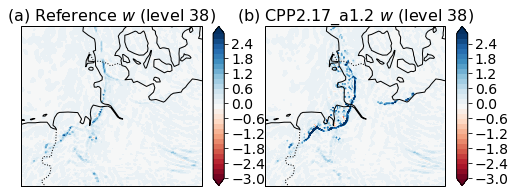

In [42]:
time = dsets['ref'].time.isel(time=15)
print(time.values)
kws = dict(levels = np.arange (-3,3,.2), cmap='RdBu')
projection = ccrs.RotatedPole(
        pole_latitude=dsets['cpp2.17_a1.2'].rotated_pole.grid_north_pole_latitude,
        pole_longitude=dsets['cpp2.17_a1.2'].rotated_pole.grid_north_pole_longitude)
fig, axs = plt.subplots(ncols=2, nrows=1, subplot_kw={'projection': projection},
                        sharex=True, sharey=True, figsize=[8,4])

axs=axs.ravel()
my_contour(dsets['ref'].W.sel(time=time, level1=38).isel(rlat=slice(280,430),rlon=slice(100,270)),figure = fig, axes = axs[0], **kws);
axs[0].set_title(r'(a) Reference $w$ (level 38)', fontsize=16)
my_contour(dsets['cpp2.17_a1.2'].W.sel(time=time, level1=38).isel(rlat=slice(280,430),rlon=slice(100,270)),figure = fig, axes = axs[1], **kws);
axs[1].set_title(r'(b) CPP2.17_a1.2 $w$ (level 38)', fontsize=16)

fig.savefig('../Figures/Paper/seabreeze_w_example_06June.svg')

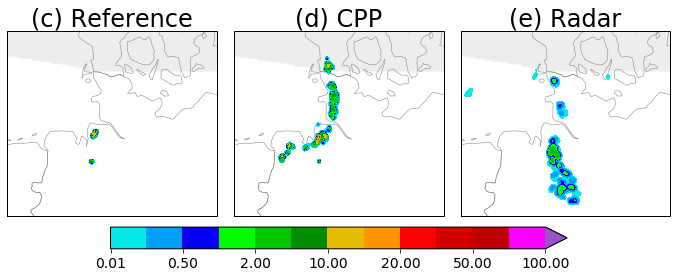

In [43]:
import matplotlib.patches as patches
levs = np.array([0.01,0.1, 0.5, 1., 2., 6., 10., 15, 20., 30, 50,
                     70, 100]) 
selected_run_list = ['reference',
                   #'cpp2.17_tanh_a1.0_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0',
                      'cpp2.17_tanh_a1.2_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0',
              #'cpp2.17_tanh_a1.5_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0',
             'radar']
for ti in [14,]:
    fig,axs = plot_prec_fields(prec_arrays.isel(rlat=slice(280,430),rlon=slice(100,270)), ti =ti, radar_mask=radar_mask, levels = levs,names = selected_run_list)
    axs[0].set_title('(c) Reference')
    axs[1].set_title('(d) CPP', )
    axs[2].set_title('(e) Radar')
    
    # Create a Rectangle patch

    
    
    
    
    fig.set_size_inches(12,4)
    fig.suptitle('')
    fig.savefig('../Figures/Paper/seabreeze_example_org_06June.svg')

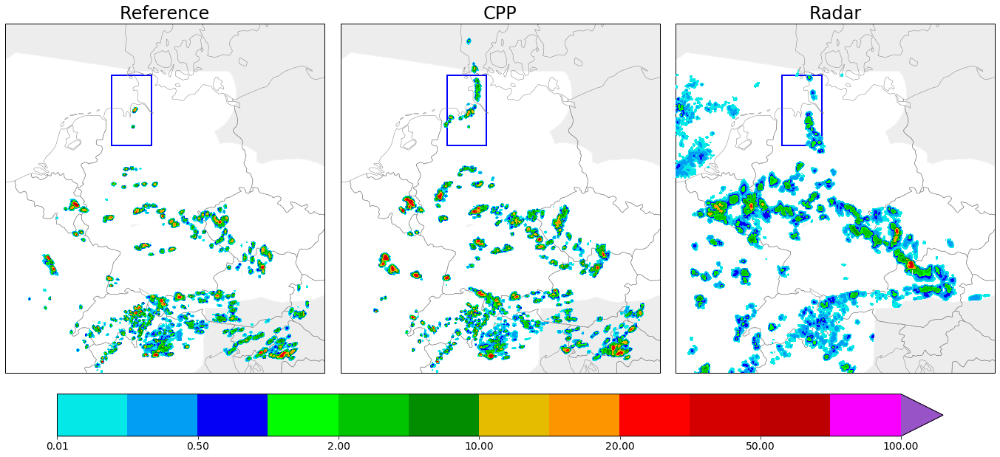

In [28]:
import matplotlib.patches as patches
levs = np.array([0.01,0.1, 0.5, 1., 2., 6., 10., 15, 20., 30, 50,
                     70, 100]) 
selected_run_list = ['reference',
                   #'cpp2.17_tanh_a1.0_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0',
                      'cpp2.17_tanh_a1.2_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0',
              #'cpp2.17_tanh_a1.5_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0',
             'radar']
for ti in [14,]:
    fig,axs = plot_prec_fields(prec_arrays, ti =ti, radar_mask=radar_mask, levels = levs,names = selected_run_list)
    axs[0].set_title('Reference')
    axs[1].set_title('CPP', )
    axs[2].set_title('Radar')
    
    # Create a Rectangle patch

    
    
    rect = patches.Rectangle((-1.5,2.5),1.3,2.3,linewidth=2,edgecolor='b',facecolor='none')
    rect2 = patches.Rectangle((-1.5,2.5),1.3,2.3,linewidth=2,edgecolor='b',facecolor='none')
    rect3 = patches.Rectangle((-1.5,2.5),1.3,2.3,linewidth=2,edgecolor='b',facecolor='none')
    # Add the patch to the Axes
    axs[0].add_patch(rect)
    axs[1].add_patch(rect2)
    axs[2].add_patch(rect3)
    
    
    fig.suptitle('')
    fig.savefig('../Figures/Paper/seabreeze_example_org_06June.png',dpi=300)

## Land sea breez - 5 June 2016

In [27]:
from misc_functions import get_prec_data, plot_prec_fields
date='20160605'

run_list =  ['reference',
                      'cpp2.17_tanh_a1.0_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0',
                      'cpp2.17_tanh_a1.2_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0',
                      'cpp2.17_tanh_a1.5_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0',
             'radar']


prec_arrays = get_prec_data(run_names = run_list, date = date)
radar_mask = get_radar_mask(date=date, use_time_dependent=False) 

100%|██████████| 5/5 [00:20<00:00,  3.62s/it]


In [28]:
from misc_functions import get_data
dsets = dict()
date = 20160605
dsets['ref'] = get_data(run_name = 'reference', load_hourly=True, date=date)
dsets['cpp2.17_a1.0'] = get_data(run_name = 'cpp2.17_tanh_a1.0_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0', load_hourly=True, date = date)
dsets['cpp2.17_a1.2'] = get_data(run_name = 'cpp2.17_tanh_a1.2_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0', load_hourly=True, date = date)
dsets['cpp2.17_a1.5'] = get_data(run_name = 'cpp2.17_tanh_a1.5_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0', load_hourly=True, date = date)

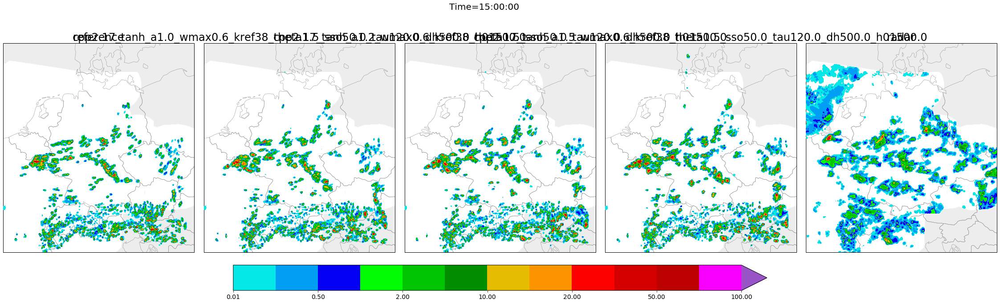

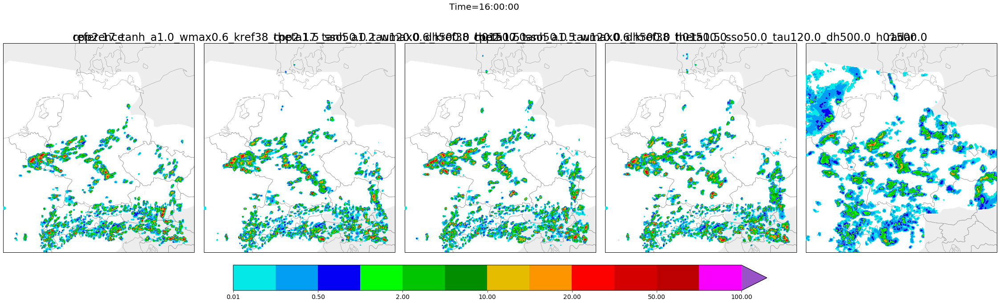

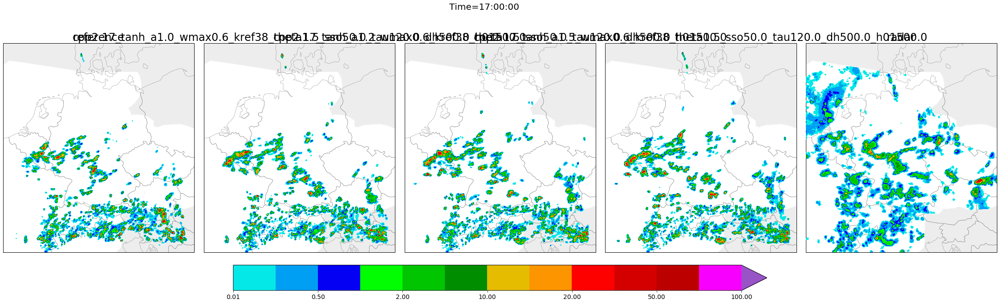

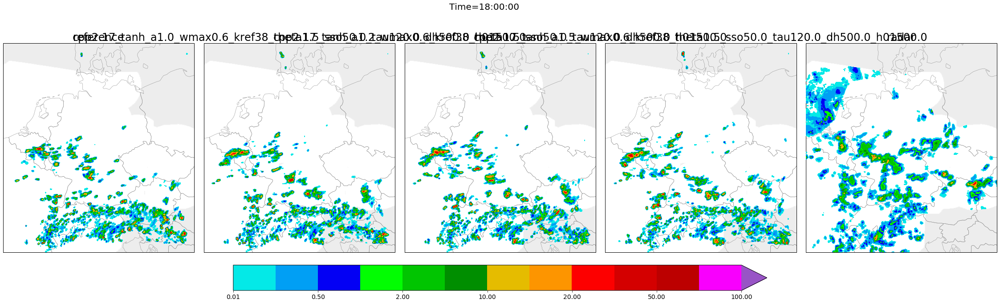

In [32]:
levs = np.array([0.01,0.1, 0.5, 1., 2., 6., 10., 15, 20., 30, 50,
                     70, 100]) 
for ti in [14,15,16, 17,]:
    fig,axs = plot_prec_fields(prec_arrays, ti =ti, radar_mask=radar_mask, levels = levs,names = run_list)

## Land sea breez 7 June 2016 
There might be a mixture of land sea breeze and cold pools that are responsible for the really strong precipitation band in the observations. 
In the models, maybe initially the land-sea breeze triggers something, but than cold pools form with further trigger and strengthen the cells. It is not very clear!



In [7]:
from misc_functions import get_prec_data, plot_prec_fields
date='20160607'

run_list =  ['reference',
                      'cpp2.17_tanh_a1.0_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0',
                      'cpp2.17_tanh_a1.2_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0',
                      'cpp2.17_tanh_a2.0_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0',
             'radar']


prec_arrays = get_prec_data(run_names = run_list, date = date)
radar_mask = get_radar_mask(date=date, use_time_dependent=False) 

100%|██████████| 5/5 [00:20<00:00,  3.67s/it]


In [10]:
from misc_functions import get_data
dsets = dict()
date = 20160607
dsets['ref'] = get_data(run_name = 'reference', load_hourly=True, date=date)
dsets['cpp2.17_a1.0'] = get_data(run_name = 'cpp2.17_tanh_a1.0_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0', load_hourly=True, date = date)
dsets['cpp2.17_a1.2'] = get_data(run_name = 'cpp2.17_tanh_a1.2_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0', load_hourly=True, date = date)
dsets['cpp2.17_a2.0'] = get_data(run_name = 'cpp2.17_tanh_a2.0_wmax0.6_kref38_theta1.5_sso50.0_tau120.0_dh500.0_h01500.0', load_hourly=True, date = date)

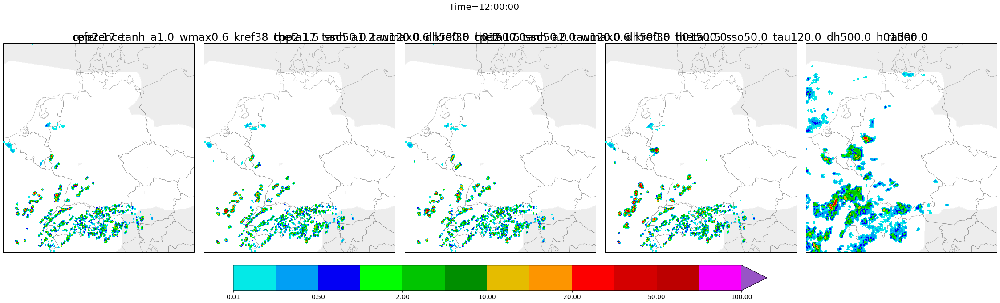

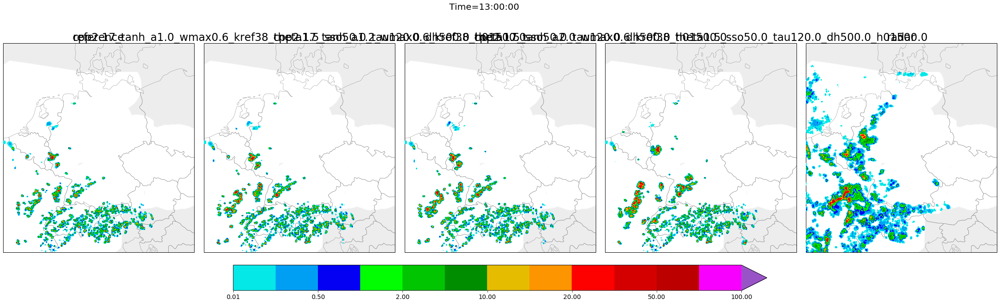

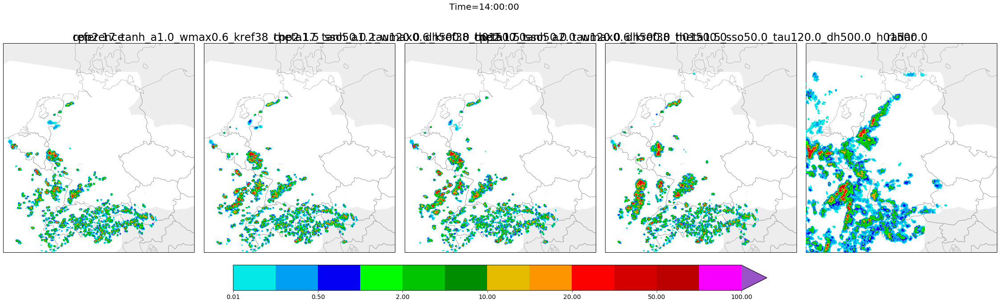

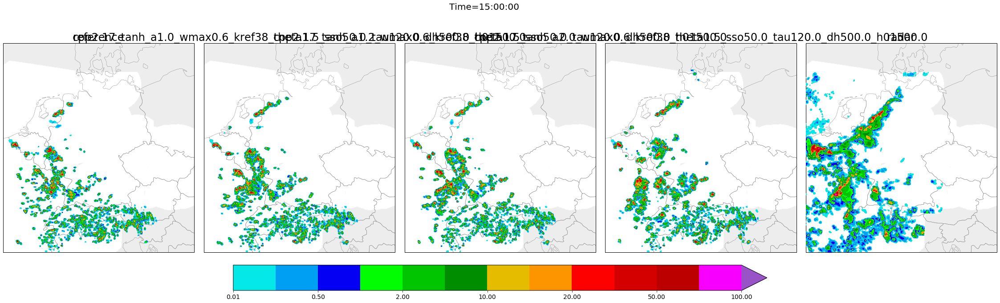

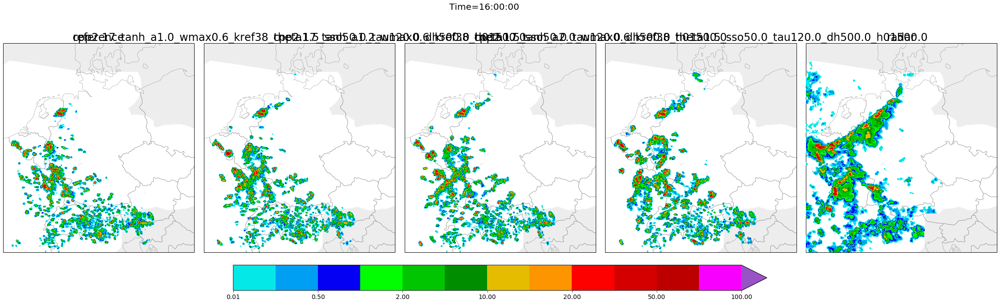

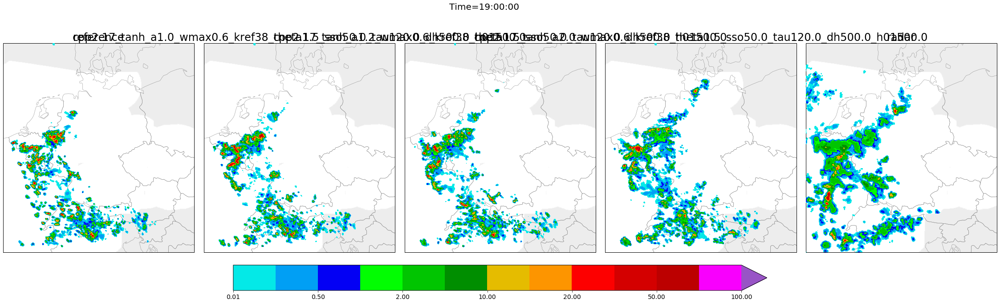

In [9]:
levs = np.array([0.01,0.1, 0.5, 1., 2., 6., 10., 15, 20., 30, 50,
                     70, 100]) 
for ti in [11,12,13,14, 15,18]:
    fig,axs = plot_prec_fields(prec_arrays, ti =ti, radar_mask=radar_mask, levels = levs,names = run_list)

2016-06-07T14:00:00.000000000


Text(0.5, 1.0, '(a) CPP2.17_a2.0 $w$ (level 38)')

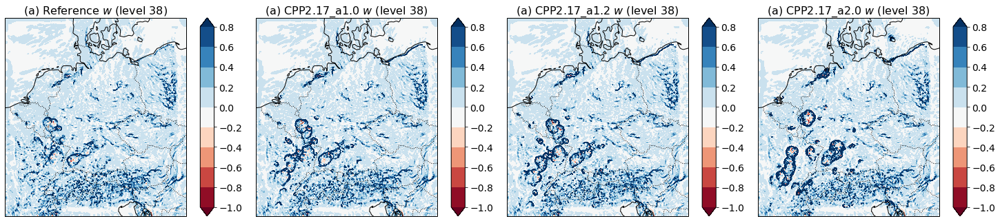

In [23]:
time = dsets['ref'].time.isel(time=14)
print(time.values)
kws = dict(levels = np.arange (-1,1,.2), cmap='RdBu')
projection = ccrs.RotatedPole(
        pole_latitude=dsets['cpp2.17_a1.2'].rotated_pole.grid_north_pole_latitude,
        pole_longitude=dsets['cpp2.17_a1.2'].rotated_pole.grid_north_pole_longitude)
fig, axs = plt.subplots(ncols=4, nrows=1, subplot_kw={'projection': projection},
                        sharex=True, sharey=True, figsize=[25,8])

axs=axs.ravel()
my_contour(dsets['ref'].W.sel(time=time, level1=38),figure = fig, axes = axs[0], **kws);
axs[0].set_title(r'(a) Reference $w$ (level 38)', fontsize=16)
my_contour(dsets['cpp2.17_a1.0'].W.sel(time=time, level1=38),figure = fig, axes = axs[1], **kws);
axs[1].set_title(r'(a) CPP2.17_a1.0 $w$ (level 38)', fontsize=16)
my_contour(dsets['cpp2.17_a1.2'].W.sel(time=time, level1=38),figure = fig, axes = axs[2], **kws);
axs[2].set_title(r'(a) CPP2.17_a1.2 $w$ (level 38)', fontsize=16)
my_contour(dsets['cpp2.17_a2.0'].W.sel(time=time, level1=38),figure = fig, axes = axs[3], **kws);
axs[3].set_title(r'(a) CPP2.17_a2.0 $w$ (level 38)', fontsize=16)


2016-06-07T14:00:00.000000000


Text(0.5, 1.0, '(a) CPP2.17_a2.0 $w$ (level 38)')

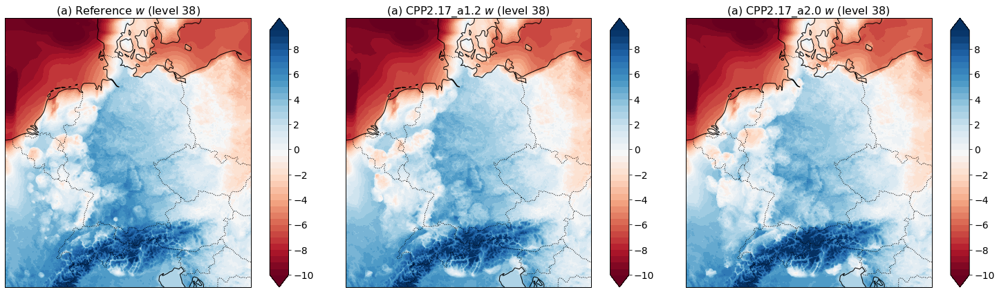

In [24]:
time = dsets['ref'].time.isel(time=14)
print(time.values)
kws = dict(levels = np.arange (-10,10,.5), cmap='RdBu')
projection = ccrs.RotatedPole(
        pole_latitude=dsets['cpp2.17_a1.2'].rotated_pole.grid_north_pole_latitude,
        pole_longitude=dsets['cpp2.17_a1.2'].rotated_pole.grid_north_pole_longitude)
fig, axs = plt.subplots(ncols=3, nrows=1, subplot_kw={'projection': projection},
                        sharex=True, sharey=True, figsize=[25,8])

axs=axs.ravel()
theta = dsets['ref'].theta_v_sfc.isel(time=ti)
theta_pert = theta - theta.mean(['rlon', 'rlat'])
my_contour(theta_pert,figure = fig, axes = axs[0], **kws);
axs[0].set_title(r'(a) Reference $w$ (level 38)', fontsize=16)

theta = dsets['cpp2.17_a1.2'].theta_v_sfc.isel(time=ti)
theta_pert = theta - theta.mean(['rlon', 'rlat'])
my_contour(theta_pert,figure = fig, axes = axs[1], **kws);
axs[1].set_title(r'(a) CPP2.17_a1.2 $w$ (level 38)', fontsize=16)

theta = dsets['cpp2.17_a2.0'].theta_v_sfc.isel(time=ti)
theta_pert = theta - theta.mean(['rlon', 'rlat'])
my_contour(theta_pert,figure = fig, axes = axs[2], **kws);
axs[2].set_title(r'(a) CPP2.17_a2.0 $w$ (level 38)', fontsize=16)
